In [1]:
# @title HW 1
# @markdown Student Info
# @markdown Name: [Skyler Thomas]
# @markdown JHED-ID: [sthom215]

# @markdown Load up the calcium image video in the file: TEST MOVIE 00001-small-motion.tif. This file represents the raw fluorescence video in TIF format, common for calcium imaging.

import os
from pathlib import Path
import numpy as np
home = Path.cwd()

# Problem 5: Matrix factorization 
The above procedure is common in many labs, however can cause errors due to the dependency on
the summary image and the multiple stages of processing. Matrix factorization has emerged as an
alternative approach for identifying ROIs from the full spatio-temporal video. Here we will explore
three different types of factorization and compare the results using a table.

## Part A

Run PCA on the pixels-by-time matrix obtained by vectorizing each frame into a column
vector.

In [2]:
# @markdown Load the video file using the provided TIFF_IO class.
from sthom215_problem_1_ex_1 import TIFF_IO

fname = 'TEST_MOVIE_00001-small-motion.tif'
tiffreader = TIFF_IO(home/fname)
movie = tiffreader.read_tiff()

In [3]:
from sthom215_problem_5_ex_1 import  PCA

pca1 = PCA(3)
trans1 = pca1.fit_transform(movie)

pca2 = PCA(20)
trans2 = pca2.fit_transform(movie)

In [8]:
import plotly.express as px
px.imshow(trans1[0,:,:],color_continuous_scale='gray')


In [9]:
px.imshow(trans2[0,:,:],color_continuous_scale='gray')

/home/skyler/Documents/SP2024/580_695/homeworks/NSC_HW1/sthom215_problem_5_ex_1.py:53: UserWarning:

FigureCanvasAgg is non-interactive, and thus cannot be shown



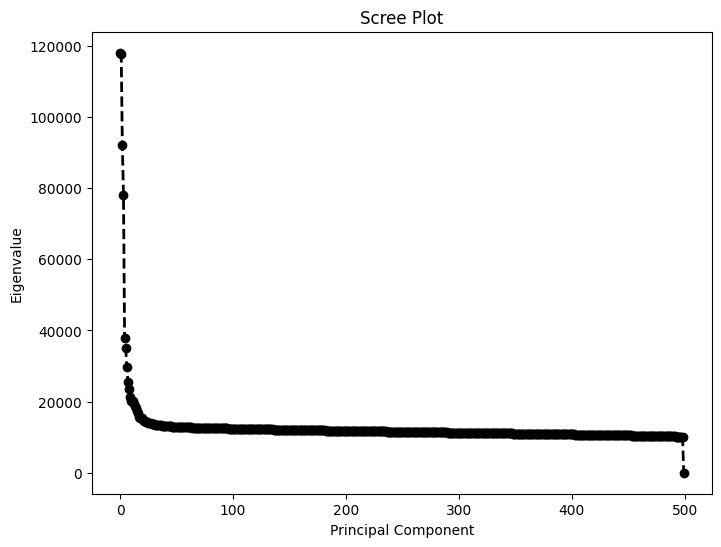

In [6]:
pca1.skree_plot()

### How does the result change with the number of principal components you choose?

With variance explained by the top 20 eigenvectors and the top 3, there is very litte if any change the pixels of reconstructed plot. Ineed, looking at the screeplot shows that the first 5 eigenvalues, and therefore the top 5 eigenvectors, dominate over the following eigenvalues. This means that there should be a change in the reconstructions betwen using the top 3 and 1 eigenvectors, but not really much after that. In the context of the movie, this means that the tiff can be condensned into approximate a 1-5 images that summarize the variance across the pixels for the entire movie. 

In [10]:
pca3 = PCA(1)
trans3 = pca3.fit_transform(movie)
px.imshow(trans3[0,:,:],color_continuous_scale='gray')
